In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from glob import glob
import numpy as np
from tqdm import tqdm

import networkx as nx
import nltk


In [7]:
# Data paths
n9_path = 'D:/FV/Personal/VIU/clean_data/9n_9ngranmarchaporlajusticia.csv'
noAlTar_path = 'D:/FV/Personal/VIU/clean_data/noaltarifazo_ruidazonacional.csv'

In [58]:
# Load and Clean data
noAlTar_df = pd.read_csv(noAlTar_path)
noAlTar_df['date'] =pd.to_datetime( noAlTar_df.hour * 3600, unit='s')
noAlTar_df['hashtag'] = noAlTar_df.hashtag.str.lower(
                        ).str.normalize('NFKD'
                        ).str.encode('ascii', errors='ignore'
                        ).str.decode('utf-8')

n9_df = pd.read_csv(n9_path)
n9_df['date'] =pd.to_datetime(n9_df.hour * 3600, unit='s')
n9_df['hashtag'] = n9_df.hashtag.str.lower(
                        ).str.normalize('NFKD'
                        ).str.encode('ascii', errors='ignore'
                        ).str.decode('utf-8')



LabelEncoder()

In [ ]:

from sklearn.preprocessing import LabelEncoder
noAltar_hash_encoder = LabelEncoder()
noAltar_hash_encoder.fit(noAlTar_df.hashtag.unique())

noAltar_user_encoder = LabelEncoder()
noAltar_user_encoder.fit(noAlTar_df.user.unique())

n9_hash_encoder = LabelEncoder()
n9_hash_encoder.fit(n9_df.hashtag.unique())

n9_user_encoder = LabelEncoder()
n9_user_encoder.fit(n9_df.user.unique())


In [51]:
str_identifier = 'hashNodes'
# str_identifier = 'userNodes'
# str_identifier = 'bipartite'

comp_metrics_path = 'D:/FV/Personal/VIU/clean_data/comp_metrics_{}.pickle'.format(str_identifier)

with open(comp_metrics_path, 'rb') as handle:
    comp_metrics = pickle.load(handle)

comp_metrics

{'9n': {'436984': {'components': [['jujuy',
     'macriyafue',
     'surrealism',
     'tvesenvivo',
     'ahora24h',
     '7dhastaluegopresidente',
     'feinmann',
     'eleccionsapunt',
     'bastadeprensacanalla',
     'fakenewsmedia',
     'conadep',
     'macrieljefedelabanda',
     'kimba',
     '50anosbasemarambio',
     'julia',
     'neuquen',
     'buenosdiasmundo',
     'zorrooooooo',
     'ecopiscinas',
     'lafugarontoda',
     'piscinasecologicas',
     'represionadocente',
     'defendelarepublica',
     'abstencion',
     'leydealquileres',
     'salta',
     'albertocristinayvos',
     'buenjueves',
     'cronicaanunciada',
     'parlament',
     'encuestaintratable',
     'auditoriaaladeudam',
     'diadelperiodistadeportivo',
     'ddhh',
     'archivorgc',
     'jodeme',
     'montegrande',
     'fichalimpia',
     'puertorico',
     'envivo',
     'stornelliaindagatoria',
     'estudiantes',
     'negrochicho',
     'rp40',
     'macrigatoenel2023',
     'patrull

# Similarity of the giant compenent using Levenshtein Distance

## 9 noviembre

In [177]:
comp_size = [len(comp_metrics_9n[key]['components'][0]) for key in comp_metrics_9n.keys()]
np.max(comp_size)

775

In [80]:
comp_metrics_9n = comp_metrics['9n']

giant_comp_per_hour_9n = {key:sorted(comp_metrics_9n[key]['components'][0]) for key in comp_metrics_9n.keys()}

giant_comp_per_hour_9n

hours_9n = sorted(giant_comp_per_hour_9n.keys())

leven_distance = np.full((len(hours_9n), len(hours_9n)), np.nan)

for i in tqdm(range(len(hours_9n))):
    for j in range(len(hours_9n)):
        if i > j:
            leven_distance[i,j] = nltk.edit_distance(giant_comp_per_hour_9n[hours_9n[i]], giant_comp_per_hour_9n[hours_9n[j]])


100%|██████████| 97/97 [11:45<00:00,  7.27s/it]


In [178]:
leven_distance_9n_df.columns

Index(['11-07 16', '11-07 17', '11-07 18', '11-07 19', '11-07 20', '11-07 21',
       '11-07 22', '11-07 23', '11-08 00', '11-08 01', '11-08 02', '11-08 03',
       '11-08 04', '11-08 05', '11-08 06', '11-08 07', '11-08 08', '11-08 09',
       '11-08 10', '11-08 11', '11-08 12', '11-08 13', '11-08 14', '11-08 15',
       '11-08 16', '11-08 17', '11-08 18', '11-08 19', '11-08 20', '11-08 21',
       '11-08 22', '11-08 23', '11-09 00', '11-09 01', '11-09 02', '11-09 03',
       '11-09 04', '11-09 05', '11-09 06', '11-09 07', '11-09 08', '11-09 09',
       '11-09 10', '11-09 11', '11-09 12', '11-09 13', '11-09 14', '11-09 15',
       '11-09 16', '11-09 17', '11-09 18', '11-09 19', '11-09 20', '11-09 21',
       '11-09 22', '11-09 23', '11-10 00', '11-10 01', '11-10 02', '11-10 03',
       '11-10 04', '11-10 05', '11-10 06', '11-10 07', '11-10 08', '11-10 09',
       '11-10 10', '11-10 11', '11-10 12', '11-10 13', '11-10 14', '11-10 15',
       '11-10 16', '11-10 17', '11-10 18', '11-10 19

<Axes: >

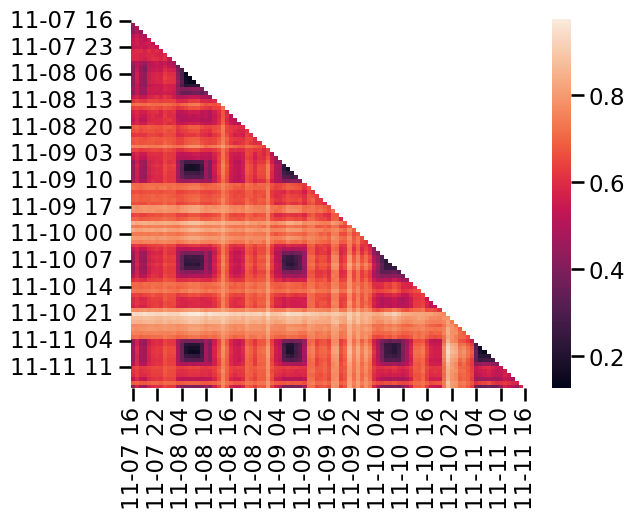

In [186]:
leven_distance_9n_df = pd.DataFrame(leven_distance, index=hours_9n, columns = hours_9n)
leven_distance_9n_df.index = [pd.to_datetime( int(hour) * 3600, unit='s').strftime('%m-%d %H') for hour in leven_distance_9n_df.index]
leven_distance_9n_df.columns = [pd.to_datetime( int(hour) * 3600, unit='s').strftime('%m-%d %H') for hour in leven_distance_9n_df.columns]
import seaborn as sns

leven_distance_9n_df = (leven_distance_9n_df) / 755

sns.heatmap(leven_distance_9n_df)


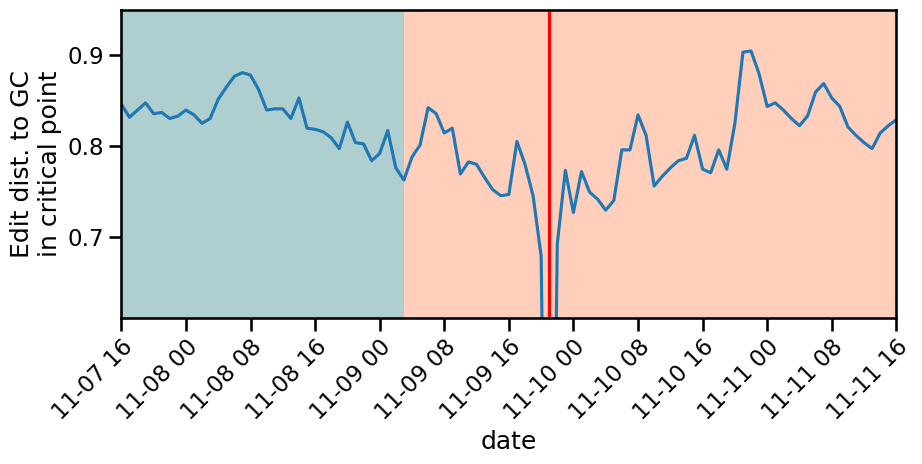

In [191]:
critical_time = '11-09 21'
period_start = '11-09 03'
def plot_Levenshtein_Distance(df, critical_time, period_start , date_step = 8):

    critical_dist_df = pd.concat([df[df.index == critical_time].dropna(axis=1), 
                                df.T[df.T.index == critical_time].dropna(axis=1)], axis=1).T
    min_dist  = critical_dist_df.min().values[0]

    critical_dist_df.loc[critical_time,:] = 0
    critical_dist_df.sort_index(inplace = True)

    critical_dist_df.reset_index(inplace = True)
    critical_dist_df.columns = ['date', 'Edit dist. to GC\nin critical point']

    fig, axes = plt.subplots(1,1, figsize = [10, 4],sharex=True)

    sns.lineplot(data = critical_dist_df, x = 'date', y = 'Edit dist. to GC\nin critical point', ax = axes)

    y_lims = axes.get_ylim()


    axes.set_ylim([min_dist - min_dist*.1, y_lims[1]])

    # Set the major ticks at intervals, e.g., every 5th tick
    axes.set_xticks(axes.get_xticks()[::date_step])

    axes.set_xticklabels(axes.get_xticklabels(), rotation = 45, ha = 'right', rotation_mode='anchor')

    axes.axvline(critical_time, color = 'red')
    axes.axvspan(critical_dist_df.date.min(), period_start, facecolor='cadetblue', alpha=0.5)
    axes.axvspan(period_start, critical_dist_df.date.max(), facecolor='lightsalmon', alpha=0.5)
    axes.set_xlim([critical_dist_df.index.min(), critical_dist_df.index.max() ]);

plot_Levenshtein_Distance(leven_distance_9n_df, critical_time, period_start)


In [188]:
comp_size = [len(comp_metrics_noAlt[key]['components'][0]) for key in comp_metrics_noAlt.keys()]
np.max(comp_size)

470

In [106]:
comp_metrics_noAlt = comp_metrics['noAlt']

giant_comp_per_hour_noAlt = {key:sorted(comp_metrics_noAlt[key]['components'][0]) for key in comp_metrics_noAlt.keys()}

giant_comp_per_hour_noAlt

hours_noAlt = sorted(giant_comp_per_hour_noAlt.keys())

leven_distance_noAlt = np.full((len(hours_noAlt), len(hours_noAlt)), np.nan)

for i in tqdm(range(len(hours_noAlt))):
    for j in range(len(hours_noAlt)):
        if i > j:
            leven_distance_noAlt[i,j] = nltk.edit_distance(giant_comp_per_hour_noAlt[hours_noAlt[i]], giant_comp_per_hour_noAlt[hours_noAlt[j]])

100%|██████████| 260/260 [05:38<00:00,  1.30s/it]


<Axes: >

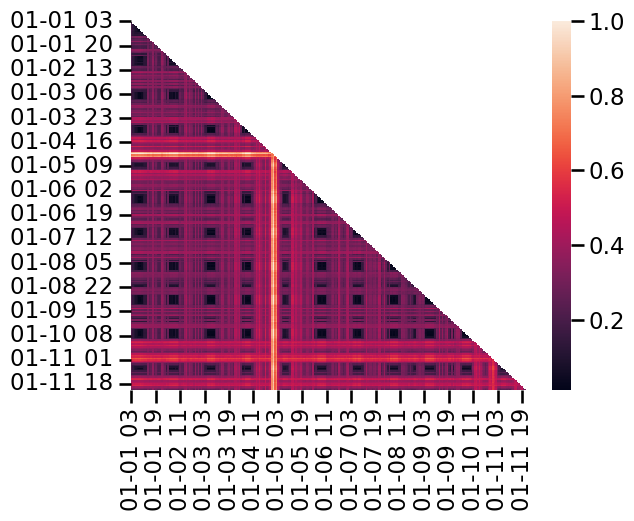

In [189]:
leven_distance_noAlt_df = pd.DataFrame(leven_distance_noAlt, index=hours_noAlt, columns = hours_noAlt)
leven_distance_noAlt_df.index = [pd.to_datetime( int(hour) * 3600, unit='s').strftime('%m-%d %H') for hour in leven_distance_noAlt_df.index]
leven_distance_noAlt_df.columns = [pd.to_datetime( int(hour) * 3600, unit='s').strftime('%m-%d %H') for hour in leven_distance_noAlt_df.columns]

leven_distance_noAlt_df = (leven_distance_noAlt_df) / 470

sns.heatmap(leven_distance_noAlt_df)

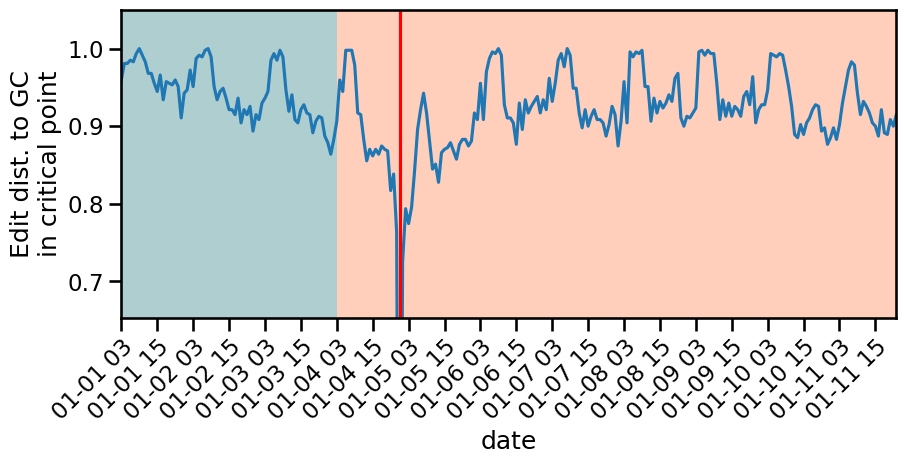

In [193]:
critical_time = '01-05 00'
period_start = '01-04 03'
plot_Levenshtein_Distance(leven_distance_noAlt_df, critical_time, period_start, date_step = 12)

In [76]:
entry = comp_metrics_9n['436984']

df

pd.DataFrame.from_dict(data = entry['eigen_cent'], orient='index').idxmax()

0    bolivia
dtype: object

In [61]:
import jellyfish
jellyfish.levenshtein_distance(['jellyfish', 'jellyfish'], ['smellyfish'])

TypeError: argument 'a': 'list' object cannot be converted to 'PyString'

In [50]:
with open('D:/FV/Personal/VIU/test.pickle', 'wb') as handle:
    pickle.dump(dic_9n, handle, protocol=pickle.HIGHEST_PROTOCOL)

with open('D:/FV/Personal/VIU/test.pickle', 'rb') as handle:
    b = pickle.load(handle)

print(dic_9n == b)

True


{'chaco': 0.0013815244220075444,
 'resistencia': 0.0013815244220075444,
 '9ngranmarchaporlajusticia': 0.08023697198830634,
 'cambiosparasiempre': 0.08089492876496698,
 'animalessueltos': 0.024268565153061278,
 'santiagodelestero': 0.0026091730400407127,
 'undiacomohoy': 0.0,
 '50anosbasemarambio': 0.0010137783980883378,
 'mundosinmaltratoanimal': 0.0005962391979067348,
 'ayudemonosentretodos': 0.0,
 'testigosprotegidos': 0.025064048911282086,
 'same': 0.0008049621626424943,
 'gabinetenacional': 0.0015727103365626226,
 'gralrodriguez': 0.0,
 'ayudanosaencontrarlos': 0.005916077139186511,
 'pfa': 0.005916077139186511,
 'medellin': 0.0,
 'trata': 0.0,
 'antartida': 0.0,
 'santafe': 0.0,
 'ddm': 0.0032043847667156348,
 'mmd': 0.0,
 'bolivia': 0.11990049137085713,
 'roman': 0.0,
 'romanxfox': 0.005277489683846935,
 'martin': 0.0,
 'riquelme': 0.009886477424712716,
 'labombonera': 0.0,
 'elsuenosehacerealidad': 0.014299203000367388,
 'edlp': 0.025229850931749082,
 'boca': 0.02574706199020953

In [14]:


l1 = ['asff', 'asfasf', 'afasf']

l2 = ['bsff', 'bsfbsf', 'bfbsf']

lf1 = l1 + l2
lf2 = l2 + l1 

le1 = LabelEncoder()
le1.fit(lf1)
l_test = ['asff', 'bfbsf', 'asfasf', 'bsfbsf', 'afasf', 'bsff']
le1.transform(l_test)

array([2, 3, 1, 4, 0, 5])

array([2, 3, 1, 4, 0, 5])

In [13]:
le2.transform(l_test)

array([2, 3, 1, 4, 0, 5])